# image captioning project

# **LSTM**

In [ ]:
import os
import re
import random
import pickle
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm import tqdm
import tensorflow as tf
from textwrap import wrap
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tensorflow.keras.utils import Sequence, plot_model, to_categorical
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import ResNet50, ResNet152V2, VGG16, DenseNet201, EfficientNetB7
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Embedding, LSTM, GRU, add, Concatenate, Reshape, concatenate, Bidirectional
from tensorflow.keras.layers import Conv2D, MaxPooling2D, GlobalAveragePooling2D, TimeDistributed, Activation, Dropout, Flatten, Dense, Input, Layer
from tensorflow.keras.applications.resnet_v2 import preprocess_input
from sklearn.model_selection import train_test_split
import torch
from torch import nn
import torchvision.models as models
import torchvision.transforms as transforms
from transformers import VisionEncoderDecoderModel, ViTImageProcessor, AutoTokenizer
from nltk.translate.bleu_score import sentence_bleu
import kagglehub


# **Data Download & Preprocessing**

In [ ]:
# Download the data
path = kagglehub.dataset_download("adityajn105/flickr8k")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/flickr8k


In [ ]:
image_path = '/kaggle/input/flickr8k/Images' # path of the images
df = pd.read_csv('/kaggle/input/flickr8k/captions.txt') # path of the dataset
df.head()

,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...


In [ ]:
!pip install nltk

In [ ]:
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_csv('/kaggle/input/flickr8k/captions.txt')

def text_preprocessing(data):
    data['caption'] = data['caption'].apply(lambda x: x.lower())
    data['caption'] = data['caption'].apply(lambda x: re.sub(r'[^a-z\s]', '', x))
    data['caption'] = data['caption'].apply(lambda x: re.sub(r'\s+', ' ', x).strip())
    data['caption'] = data['caption'].apply(lambda x: ' '.join([word for word in x.split() if len(word) > 1 or word in ['a', 'i']]))
    data['caption'] = data['caption'].apply(lambda x: 'startseq ' + x + ' endseq')
    return data

df = text_preprocessing(df)

tokenizer = Tokenizer()
tokenizer.fit_on_texts(df['caption'].tolist())
vocab_size = len(tokenizer.word_index) + 1
max_length = max(len(c.split()) for c in df['caption'])

train_images, val_images = train_test_split(df['image'].unique(), test_size=0.15, random_state=42)

# **Resnet Model**

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

resnet = models.resnet152(pretrained=True)
resnet = nn.Sequential(*list(resnet.children())[:-1])  # remove the final FC layer
resnet.to(device)
resnet.eval()

transform = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

In [ ]:
features = {}

image_path = '/kaggle/input/flickr8k/Images'
for image in tqdm(df['image'].unique()):
    img = Image.open(os.path.join(image_path, image)).convert('RGB')
    img_tensor = transform(img).unsqueeze(0).to(device)
    with torch.no_grad():
        feature = resnet(img_tensor).squeeze().cpu().numpy()
    features[image] = feature


100%|██████████| 8091/8091 [09:41<00:00, 13.92it/s]


In [ ]:
class CaptionDataset(Dataset):
    def __init__(self, df, tokenizer, features, max_length, vocab_size):
        self.data = df
        self.tokenizer = tokenizer
        self.features = features
        self.max_length = max_length
        self.vocab_size = vocab_size
        self.samples = self._create_samples()

    def _create_samples(self):
        samples = []
        for _, row in self.data.iterrows():
            image = row['image']
            caption = row['caption']
            seq = self.tokenizer.texts_to_sequences([caption])[0]
            for i in range(1, len(seq)):
                in_seq = pad_sequences([seq[:i]], maxlen=self.max_length)[0]
                out_seq = seq[i]
                samples.append((self.features[image], in_seq, out_seq))
        return samples

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        X_img, X_seq, y = self.samples[idx]
        return (
            torch.tensor(X_img, dtype=torch.float32),
            torch.tensor(X_seq, dtype=torch.long),
            torch.tensor(y, dtype=torch.long)
        )


# **LSTM Model Architecture**

In [ ]:
class CaptionModel(nn.Module):
    def __init__(self, vocab_size, max_length):
        super(CaptionModel, self).__init__()
        self.img_fc = nn.Linear(2048, 256)
        self.embedding = nn.Embedding(vocab_size, 256)
        self.lstm = nn.LSTM(256, 256, batch_first=True)
        self.fc1 = nn.Linear(256, 128)
        self.fc2 = nn.Linear(128, vocab_size)
        self.dropout = nn.Dropout(0.5)

    def forward(self, image, sequence):
        img_feat = torch.relu(self.img_fc(image)).unsqueeze(1)
        seq_embed = self.embedding(sequence)
        merged = torch.cat((img_feat, seq_embed), dim=1)
        lstm_out, _ = self.lstm(merged)
        x = self.dropout(lstm_out[:, -1, :])
        x = x + img_feat.squeeze(1)
        x = torch.relu(self.fc1(x))
        x = self.dropout(x)
        out = self.fc2(x)
        return out

In [ ]:
train_dataset = CaptionDataset(df[df['image'].isin(train_images)], tokenizer, features, max_length, vocab_size)
val_dataset = CaptionDataset(df[df['image'].isin(val_images)], tokenizer, features, max_length, vocab_size)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64)

model = CaptionModel(vocab_size, max_length).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)


# **Train the Model**

In [ ]:
for epoch in range(50):
    model.train()
    running_loss = 0.0
    for X_img, X_seq, y in tqdm(train_loader):
        X_img, X_seq, y = X_img.to(device), X_seq.to(device), y.to(device)

        optimizer.zero_grad()
        outputs = model(X_img, X_seq)
        loss = criterion(outputs, y)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    print(f"Epoch {epoch+1} Loss: {running_loss / len(train_loader):.4f}")


100%|██████████| 6325/6325 [00:51<00:00, 123.43it/s]


Epoch 1 Loss: 4.3210


100%|██████████| 6325/6325 [00:48<00:00, 131.18it/s]


Epoch 2 Loss: 3.8946


100%|██████████| 6325/6325 [00:50<00:00, 125.38it/s]


Epoch 3 Loss: 3.7767


100%|██████████| 6325/6325 [00:48<00:00, 130.35it/s]


Epoch 4 Loss: 3.7089


100%|██████████| 6325/6325 [00:49<00:00, 127.94it/s]


Epoch 5 Loss: 3.6777


100%|██████████| 6325/6325 [00:48<00:00, 129.91it/s]


Epoch 6 Loss: 3.6617


100%|██████████| 6325/6325 [00:50<00:00, 126.04it/s]


Epoch 7 Loss: 3.6496


100%|██████████| 6325/6325 [00:47<00:00, 131.83it/s]


Epoch 8 Loss: 3.6453


100%|██████████| 6325/6325 [00:48<00:00, 130.58it/s]


Epoch 9 Loss: 3.6447


100%|██████████| 6325/6325 [00:50<00:00, 125.64it/s]


Epoch 10 Loss: 3.6476


100%|██████████| 6325/6325 [00:50<00:00, 125.96it/s]


Epoch 11 Loss: 3.6501


100%|██████████| 6325/6325 [00:48<00:00, 130.31it/s]


Epoch 12 Loss: 3.6563


100%|██████████| 6325/6325 [00:48<00:00, 130.06it/s]


Epoch 13 Loss: 3.6590


100%|██████████| 6325/6325 [00:47<00:00, 132.72it/s]


Epoch 14 Loss: 3.6620


100%|██████████| 6325/6325 [00:48<00:00, 130.49it/s]


Epoch 15 Loss: 3.6657


100%|██████████| 6325/6325 [00:48<00:00, 130.62it/s]


Epoch 16 Loss: 3.6725


100%|██████████| 6325/6325 [00:50<00:00, 124.99it/s]


Epoch 17 Loss: 3.6730


100%|██████████| 6325/6325 [00:49<00:00, 127.17it/s]


Epoch 18 Loss: 3.6886


100%|██████████| 6325/6325 [00:48<00:00, 129.44it/s]


Epoch 19 Loss: 3.6899


100%|██████████| 6325/6325 [00:47<00:00, 132.27it/s]


Epoch 20 Loss: 3.7009


100%|██████████| 6325/6325 [00:47<00:00, 132.33it/s]


Epoch 21 Loss: 3.7063


100%|██████████| 6325/6325 [00:47<00:00, 132.18it/s]


Epoch 22 Loss: 3.7104


100%|██████████| 6325/6325 [00:47<00:00, 132.24it/s]


Epoch 23 Loss: 3.7215


100%|██████████| 6325/6325 [00:47<00:00, 132.37it/s]


Epoch 24 Loss: 3.7286


100%|██████████| 6325/6325 [00:47<00:00, 132.63it/s]


Epoch 25 Loss: 3.7332


100%|██████████| 6325/6325 [00:47<00:00, 132.69it/s]


Epoch 26 Loss: 3.7370


100%|██████████| 6325/6325 [00:47<00:00, 132.64it/s]


Epoch 27 Loss: 3.7506


100%|██████████| 6325/6325 [00:47<00:00, 132.28it/s]


Epoch 28 Loss: 3.7517


100%|██████████| 6325/6325 [00:47<00:00, 132.09it/s]


Epoch 29 Loss: 3.7597


100%|██████████| 6325/6325 [00:48<00:00, 131.49it/s]


Epoch 30 Loss: 3.7718


100%|██████████| 6325/6325 [00:48<00:00, 131.30it/s]


Epoch 31 Loss: 3.7679


100%|██████████| 6325/6325 [00:47<00:00, 131.83it/s]


Epoch 32 Loss: 3.7811


100%|██████████| 6325/6325 [00:48<00:00, 130.32it/s]


Epoch 33 Loss: 3.7863


100%|██████████| 6325/6325 [00:48<00:00, 130.26it/s]


Epoch 34 Loss: 3.7951


100%|██████████| 6325/6325 [00:48<00:00, 130.09it/s]


Epoch 35 Loss: 3.7976


100%|██████████| 6325/6325 [00:49<00:00, 129.00it/s]


Epoch 36 Loss: 3.8068


100%|██████████| 6325/6325 [00:48<00:00, 130.79it/s]


Epoch 37 Loss: 3.8164


100%|██████████| 6325/6325 [00:48<00:00, 130.73it/s]


Epoch 38 Loss: 3.8161


100%|██████████| 6325/6325 [00:48<00:00, 130.92it/s]


Epoch 39 Loss: 3.8266


100%|██████████| 6325/6325 [00:49<00:00, 128.22it/s]


Epoch 40 Loss: 3.8339


100%|██████████| 6325/6325 [00:50<00:00, 125.61it/s]


Epoch 41 Loss: 3.8365


100%|██████████| 6325/6325 [00:50<00:00, 125.22it/s]


Epoch 42 Loss: 3.8427


100%|██████████| 6325/6325 [00:50<00:00, 125.08it/s]


Epoch 43 Loss: 3.8521


100%|██████████| 6325/6325 [00:50<00:00, 124.90it/s]


Epoch 44 Loss: 3.8579


100%|██████████| 6325/6325 [00:50<00:00, 125.64it/s]


Epoch 45 Loss: 3.8575


100%|██████████| 6325/6325 [00:49<00:00, 127.25it/s]


Epoch 46 Loss: 3.8748


100%|██████████| 6325/6325 [00:49<00:00, 126.91it/s]


Epoch 47 Loss: 3.8758


100%|██████████| 6325/6325 [00:49<00:00, 128.00it/s]


Epoch 48 Loss: 3.8714


100%|██████████| 6325/6325 [00:47<00:00, 132.58it/s]


Epoch 49 Loss: 3.8849


100%|██████████| 6325/6325 [00:47<00:00, 131.85it/s]

Epoch 50 Loss: 3.8976


In [ ]:
def generate_caption(model, tokenizer, feature, max_length):
    model.eval()
    in_text = 'startseq'
    for _ in range(max_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], maxlen=max_length)
        seq_tensor = torch.tensor(sequence, dtype=torch.long).to(device)
        feature_tensor = torch.tensor(feature, dtype=torch.float32).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(feature_tensor, seq_tensor)
            yhat = output.argmax(1).item()

        word = next((w for w, idx in tokenizer.word_index.items() if idx == yhat), None)
        if word is None or word == 'endseq':
            break
        in_text += ' ' + word
    return ' '.join(in_text.split()[1:])


# Handle the image before enter to the generate_caption function and print the caption and plot the image
def predict_one_image(image_path, model, tokenizer, max_length):
    # Load image
    img = Image.open(image_path).convert('RGB')

    # Preprocess image
    transform = transforms.Compose([
        transforms.Resize((600, 600)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    img_tensor = transform(img).unsqueeze(0).to(device)

    # Extract features from ResNet
    with torch.no_grad():
        feature = resnet(img_tensor).squeeze().cpu().numpy()

    # Generate caption
    caption = generate_caption(model, tokenizer, feature, max_length)

    # Display results
    print("Predicted Caption:", caption)
    plt.imshow(img)
    plt.axis('off')
    plt.title(caption)
    plt.show()

    return caption


In [ ]:
def calculate_bleu_score(image_name, model, tokenizer, max_length, df, image_dir):
    # Get reference captions for the image
    references = df[df['image'] == image_name]['caption'].tolist()
    references = [ref.split() for ref in references]  # tokenize

    # Get predicted caption
    predicted = predict_one_image(os.path.join(image_dir, image_name), model, tokenizer, max_length)
    candidate = predicted.split()  # tokenize

    # BLEU calculation
    smoothie = SmoothingFunction().method4
    bleu1 = sentence_bleu(references, candidate, weights=(1, 0, 0, 0), smoothing_function=smoothie)
    bleu2 = sentence_bleu(references, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothie)
    bleu4 = sentence_bleu(references, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothie)

    print(f"BLEU-1: {bleu1:.4f}, BLEU-2: {bleu2:.4f}, BLEU-4: {bleu4:.4f}")
    return bleu1, bleu2, bleu4


Predicted Caption: a dog is running in the grass


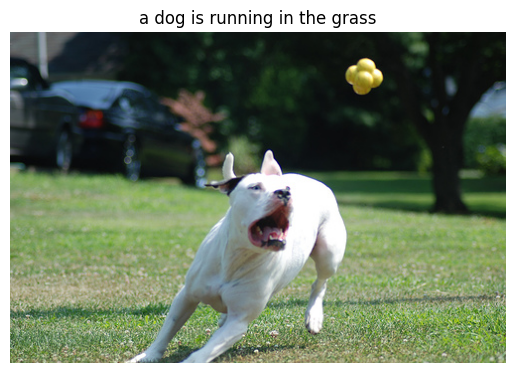

BLEU-1: 0.5584, BLEU-2: 0.3482, BLEU-4: 0.0835


In [ ]:
image_name = "1019604187_d087bf9a5f.jpg"
image_dir = "/kaggle/input/flickr8k/Images"

bleu1, bleu2, bleu4 = calculate_bleu_score(image_name=image_name, model=model, tokenizer=tokenizer, max_length=max_length, df=df, image_dir=image_dir)

# **GRU**

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

resnet = models.resnet152(pretrained=True)
resnet = nn.Sequential(*list(resnet.children())[:-1])  # remove the final FC layer
resnet.to(device)
resnet.eval()

transform = transforms.Compose([
    transforms.Resize((600, 600)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                         std=[0.229, 0.224, 0.225])
])

Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:01<00:00, 185MB/s]


## **Preprocessing**

In [ ]:
df = pd.read_csv('/kaggle/input/flickr8k/captions.txt')

def text_preprocessing(data):
    data['caption'] = data['caption'].apply(lambda x: x.lower())
    data['caption'] = data['caption'].apply(lambda x: re.sub(r'[^a-z\s]', '', x))
    data['caption'] = data['caption'].apply(lambda x: re.sub(r'\s+', ' ', x).strip())
    data['caption'] = data['caption'].apply(lambda x: ' '.join([word for word in x.split() if len(word) > 1 or word in ['a', 'i']]))
    data['caption'] = data['caption'].apply(lambda x: 'startseq ' + x + ' endseq')
    return data

df = text_preprocessing(df)

tokenizer = Tokenizer()
tokenizer.fit_on_texts(df['caption'].tolist())
vocab_size = len(tokenizer.word_index) + 1
max_length = max(len(c.split()) for c in df['caption'])

train_images, val_images = train_test_split(df['image'].unique(), test_size=0.15, random_state=42)

## **Features**

In [ ]:
features = {}

image_path = '/kaggle/input/flickr8k/Images'
for image in tqdm(df['image'].unique()):
    img = Image.open(os.path.join(image_path, image)).convert('RGB')
    img_tensor = transform(img).unsqueeze(0).to(device)
    with torch.no_grad():
        feature = resnet(img_tensor).squeeze().cpu().numpy()
    features[image] = feature

100%|██████████| 8091/8091 [09:23<00:00, 14.37it/s]


## **Caption Generator**

In [ ]:
class CaptionDataset(Dataset):
    def __init__(self, df, tokenizer, features, max_length, vocab_size):
        self.data = df
        self.tokenizer = tokenizer
        self.features = features
        self.max_length = max_length
        self.vocab_size = vocab_size
        self.samples = self._create_samples()

    def _create_samples(self):
        samples = []
        for _, row in self.data.iterrows():
            image = row['image']
            caption = row['caption']
            seq = self.tokenizer.texts_to_sequences([caption])[0]
            for i in range(1, len(seq)):
                in_seq = pad_sequences([seq[:i]], maxlen=self.max_length)[0]
                out_seq = seq[i]
                samples.append((self.features[image], in_seq, out_seq))
        return samples

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        X_img, X_seq, y = self.samples[idx]
        return (
            torch.tensor(X_img, dtype=torch.float32),
            torch.tensor(X_seq, dtype=torch.long),
            torch.tensor(y, dtype=torch.long)
        )

In [ ]:
class CaptionModel(nn.Module):
    def __init__(self, vocab_size, max_length):
        super(CaptionModel, self).__init__()
        self.img_fc = nn.Linear(2048, 256)
        self.embedding = nn.Embedding(vocab_size, 256)
        self.gru = nn.GRU(256, 256, batch_first=True)
        self.fc1 = nn.Linear(256, 128)
        self.fc2 = nn.Linear(128, vocab_size)
        self.dropout = nn.Dropout(0.5)

    def forward(self, image, sequence):
        img_feat = torch.relu(self.img_fc(image)).unsqueeze(1)
        seq_embed = self.embedding(sequence)
        merged = torch.cat((img_feat, seq_embed), dim=1)
        gru_out, _ = self.gru(merged)
        x = self.dropout(gru_out[:, -1, :])
        x = x + img_feat.squeeze(1)
        x = torch.relu(self.fc1(x))
        x = self.dropout(x)
        out = self.fc2(x)
        return out


## **Training**

In [ ]:
train_dataset = CaptionDataset(df[df['image'].isin(train_images)], tokenizer, features, max_length, vocab_size)
val_dataset = CaptionDataset(df[df['image'].isin(val_images)], tokenizer, features, max_length, vocab_size)

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64)

model = CaptionModel(vocab_size, max_length).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-3)

In [ ]:
for epoch in range(50):
    model.train()
    running_loss = 0.0
    for X_img, X_seq, y in tqdm(train_loader):
        X_img, X_seq, y = X_img.to(device), X_seq.to(device), y.to(device)

        optimizer.zero_grad()
        outputs = model(X_img, X_seq)
        loss = criterion(outputs, y)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    print(f"Epoch {epoch+1} Loss: {running_loss / len(train_loader):.4f}")

100%|██████████| 6325/6325 [00:46<00:00, 135.35it/s]


Epoch 1 Loss: 4.4519


100%|██████████| 6325/6325 [00:46<00:00, 135.74it/s]


Epoch 2 Loss: 4.1412


100%|██████████| 6325/6325 [00:46<00:00, 136.60it/s]


Epoch 3 Loss: 4.1056


100%|██████████| 6325/6325 [00:46<00:00, 136.47it/s]


Epoch 4 Loss: 4.1275


100%|██████████| 6325/6325 [00:46<00:00, 137.28it/s]


Epoch 5 Loss: 4.1708


100%|██████████| 6325/6325 [00:46<00:00, 136.21it/s]


Epoch 6 Loss: 4.2118


100%|██████████| 6325/6325 [00:46<00:00, 135.80it/s]


Epoch 7 Loss: 4.2614


100%|██████████| 6325/6325 [00:45<00:00, 139.56it/s]


Epoch 8 Loss: 4.3003


100%|██████████| 6325/6325 [00:46<00:00, 137.08it/s]


Epoch 9 Loss: 4.3331


100%|██████████| 6325/6325 [00:46<00:00, 136.56it/s]


Epoch 10 Loss: 4.3656


100%|██████████| 6325/6325 [00:46<00:00, 136.82it/s]


Epoch 11 Loss: 4.3991


100%|██████████| 6325/6325 [00:46<00:00, 136.96it/s]


Epoch 12 Loss: 4.4335


100%|██████████| 6325/6325 [00:45<00:00, 137.79it/s]


Epoch 13 Loss: 4.4557


100%|██████████| 6325/6325 [00:46<00:00, 135.91it/s]


Epoch 14 Loss: 4.4919


100%|██████████| 6325/6325 [00:46<00:00, 135.66it/s]


Epoch 15 Loss: 4.5209


100%|██████████| 6325/6325 [00:46<00:00, 136.34it/s]


Epoch 16 Loss: 4.5466


100%|██████████| 6325/6325 [00:46<00:00, 136.22it/s]


Epoch 17 Loss: 4.5817


100%|██████████| 6325/6325 [00:45<00:00, 137.75it/s]


Epoch 18 Loss: 4.6101


100%|██████████| 6325/6325 [00:46<00:00, 135.76it/s]


Epoch 19 Loss: 4.6383


100%|██████████| 6325/6325 [00:46<00:00, 135.65it/s]


Epoch 20 Loss: 4.6668


100%|██████████| 6325/6325 [00:46<00:00, 136.92it/s]


Epoch 21 Loss: 4.6801


100%|██████████| 6325/6325 [00:46<00:00, 136.37it/s]


Epoch 22 Loss: 4.7083


100%|██████████| 6325/6325 [00:45<00:00, 137.84it/s]


Epoch 23 Loss: 4.7322


100%|██████████| 6325/6325 [00:46<00:00, 136.34it/s]


Epoch 24 Loss: 4.7450


100%|██████████| 6325/6325 [00:46<00:00, 136.19it/s]


Epoch 25 Loss: 4.7796


100%|██████████| 6325/6325 [00:46<00:00, 136.27it/s]


Epoch 26 Loss: 4.7978


100%|██████████| 6325/6325 [00:46<00:00, 136.34it/s]


Epoch 27 Loss: 4.8162


100%|██████████| 6325/6325 [00:45<00:00, 139.04it/s]


Epoch 28 Loss: 4.8389


100%|██████████| 6325/6325 [00:46<00:00, 135.71it/s]


Epoch 29 Loss: 4.8521


100%|██████████| 6325/6325 [00:46<00:00, 135.70it/s]


Epoch 30 Loss: 4.8664


100%|██████████| 6325/6325 [00:46<00:00, 136.37it/s]


Epoch 31 Loss: 4.8846


100%|██████████| 6325/6325 [00:46<00:00, 136.09it/s]


Epoch 32 Loss: 4.8969


100%|██████████| 6325/6325 [00:45<00:00, 138.37it/s]


Epoch 33 Loss: 4.9174


100%|██████████| 6325/6325 [00:46<00:00, 136.71it/s]


Epoch 34 Loss: 4.9319


100%|██████████| 6325/6325 [00:45<00:00, 137.65it/s]


Epoch 35 Loss: 4.9353


100%|██████████| 6325/6325 [00:46<00:00, 136.67it/s]


Epoch 36 Loss: 4.9545


100%|██████████| 6325/6325 [00:46<00:00, 136.61it/s]


Epoch 37 Loss: 4.9630


100%|██████████| 6325/6325 [00:45<00:00, 138.06it/s]


Epoch 38 Loss: 4.9844


100%|██████████| 6325/6325 [00:46<00:00, 136.51it/s]


Epoch 39 Loss: 5.0013


100%|██████████| 6325/6325 [00:46<00:00, 136.75it/s]


Epoch 40 Loss: 5.0135


100%|██████████| 6325/6325 [00:46<00:00, 137.28it/s]


Epoch 41 Loss: 5.0109


100%|██████████| 6325/6325 [00:45<00:00, 138.16it/s]


Epoch 42 Loss: 5.0199


100%|██████████| 6325/6325 [00:46<00:00, 137.25it/s]


Epoch 43 Loss: 5.0314


100%|██████████| 6325/6325 [00:46<00:00, 136.56it/s]


Epoch 44 Loss: 5.0429


100%|██████████| 6325/6325 [00:46<00:00, 136.67it/s]


Epoch 45 Loss: 5.0408


100%|██████████| 6325/6325 [00:46<00:00, 136.25it/s]


Epoch 46 Loss: 5.0696


100%|██████████| 6325/6325 [00:45<00:00, 138.04it/s]


Epoch 47 Loss: 5.0650


100%|██████████| 6325/6325 [00:45<00:00, 137.60it/s]


Epoch 48 Loss: 5.0683


100%|██████████| 6325/6325 [00:46<00:00, 136.63it/s]


Epoch 49 Loss: 5.0831


100%|██████████| 6325/6325 [00:46<00:00, 137.04it/s]

Epoch 50 Loss: 5.0849


## **Generate Captions**

In [ ]:
def generate_caption(model, tokenizer, feature, max_length):
    model.eval()
    in_text = 'startseq'
    for _ in range(max_length):
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        sequence = pad_sequences([sequence], maxlen=max_length)
        seq_tensor = torch.tensor(sequence, dtype=torch.long).to(device)
        feature_tensor = torch.tensor(feature, dtype=torch.float32).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(feature_tensor, seq_tensor)
            yhat = output.argmax(1).item()

        word = next((w for w, idx in tokenizer.word_index.items() if idx == yhat), None)
        if word is None or word == 'endseq':
            break
        in_text += ' ' + word
    return ' '.join(in_text.split()[1:])

## **Testing**

In [ ]:
# Handle the image before enter to the generate_caption function and print the caption and plot the image
def predict_one_image(image_path, model, tokenizer, max_length):
    # Load image
    img = Image.open(image_path).convert('RGB')

    # Preprocess image
    transform = transforms.Compose([
        transforms.Resize((600, 600)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225])
    ])
    img_tensor = transform(img).unsqueeze(0).to(device)

    # Extract features from ResNet
    with torch.no_grad():
        feature = resnet(img_tensor).squeeze().cpu().numpy()

    # Generate caption
    caption = generate_caption(model, tokenizer, feature, max_length)

    # Display results
    print("Predicted Caption:", caption)
    plt.imshow(img)
    plt.axis('off')
    plt.title(caption)
    plt.show()

    return caption


In [ ]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction

In [ ]:
def calculate_bleu_score(image_name, model, tokenizer, max_length, df, image_dir):
    # Get reference captions for the image
    references = df[df['image'] == image_name]['caption'].tolist()
    references = [ref.split() for ref in references]  # tokenize

    # Get predicted caption
    predicted = predict_one_image(os.path.join(image_dir, image_name), model, tokenizer, max_length)
    candidate = predicted.split()  # tokenize

    # BLEU calculation
    smoothie = SmoothingFunction().method4
    bleu1 = sentence_bleu(references, candidate, weights=(1, 0, 0, 0), smoothing_function=smoothie)
    bleu2 = sentence_bleu(references, candidate, weights=(0.5, 0.5, 0, 0), smoothing_function=smoothie)
    bleu4 = sentence_bleu(references, candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothie)

    print(f"BLEU-1: {bleu1:.4f}, BLEU-2: {bleu2:.4f}, BLEU-4: {bleu4:.4f}")
    return bleu1, bleu2, bleu4

Predicted Caption: a black dog is running through a field


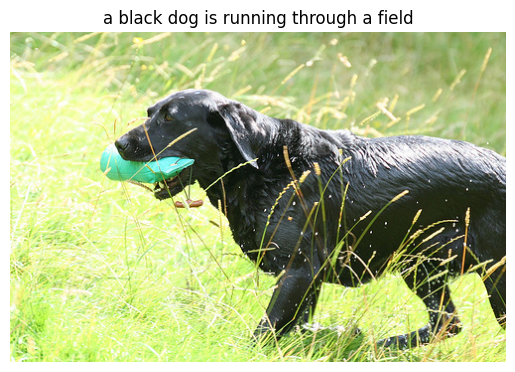

BLEU-1: 0.5841, BLEU-2: 0.4415, BLEU-4: 0.2012


In [ ]:
image_name = "1026685415_0431cbf574.jpg"
image_dir = "/kaggle/input/flickr8k/Images"


bleu1, bleu2, bleu4 = calculate_bleu_score(image_name=image_name, model=model, tokenizer=tokenizer, max_length=max_length, df=df, image_dir=image_dir)

#**BART**

In [ ]:
import pandas as pd
import os

# Download the data using kagglehub
path = kagglehub.dataset_download("adityajn105/flickr8k")
print("Path to dataset files:", path)

# Load the captions CSV file into a DataFrame
df = pd.read_csv('/kaggle/input/flickr8k/captions.txt')
df.head()  # Display first few rows of the captions file

# Define the path to the image directory
image_path = '/kaggle/input/flickr8k/Images'


Path to dataset files: /kaggle/input/flickr8k


In [ ]:
df

,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...
...,...,...
40450,997722733_0cb5439472.jpg,A man in a pink shirt climbs a rock face
40451,997722733_0cb5439472.jpg,A man is rock climbing high in the air .
40452,997722733_0cb5439472.jpg,A person in a red shirt climbing up a rock fac...
40453,997722733_0cb5439472.jpg,A rock climber in a red shirt .


In [ ]:
import re

def text_preprocessing(data):
    # Convert captions to lowercase
    data['caption'] = data['caption'].apply(lambda x: x.lower())

    # Remove non-alphabetic characters
    data['caption'] = data['caption'].apply(lambda x: re.sub(r'[^a-z\s]', '', x))

    # Remove extra spaces
    data['caption'] = data['caption'].apply(lambda x: re.sub(r'\s+', ' ', x).strip())

    # Add startseq and endseq tokens to the caption
    data['caption'] = data['caption'].apply(lambda x: 'startseq ' + x + ' endseq')

    return data

# Apply preprocessing to the captions
df = text_preprocessing(df)
df.head()  # Check the first few rows after preprocessing


,image,caption
0,1000268201_693b08cb0e.jpg,startseq a child in a pink dress is climbing u...
1,1000268201_693b08cb0e.jpg,startseq a girl going into a wooden building e...
2,1000268201_693b08cb0e.jpg,startseq a little girl climbing into a wooden ...
3,1000268201_693b08cb0e.jpg,startseq a little girl climbing the stairs to ...
4,1000268201_693b08cb0e.jpg,startseq a little girl in a pink dress going i...


In [ ]:


# Initialize ResNet-152 pre-trained model (without the final fully connected layer)
resnet_model = models.resnet152(pretrained=True)
resnet_model = torch.nn.Sequential(*list(resnet_model.children())[:-1])  # Remove last FC layer
resnet_model.eval()  # Set model to evaluation mode

# Image transformations to match the ResNet input format
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))  # Pre-trained ResNet normalization
])

# Function to extract features from an image
def extract_image_features(image_path, model, transform, device):
    image = Image.open(image_path).convert('RGB')
    image = transform(image).unsqueeze(0)  # Add batch dimension
    image = image.to(device)

    with torch.no_grad():
        features = model(image)  # Extract features
    return features.squeeze().cpu().numpy()  # Convert features to numpy array

# Set device to CUDA (GPU) if available, else use CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
resnet_model.to(device)

# Extract features for all images and store them in a dictionary
features_dict = {}
image_files = [f for f in os.listdir(image_path) if f.endswith(('.jpg', '.jpeg', '.png'))]
print(f"Total images to process: {len(image_files)}")

for img_file in tqdm(image_files):
    img_path = os.path.join(image_path, img_file)
    features_dict[img_file] = extract_image_features(img_path, resnet_model, transform, device)

# Save features to a file
with open('image_features_flickr8k.pkl', 'wb') as f:
    pickle.dump(features_dict, f)

print(f"Features extracted and saved for {len(features_dict)} images!")


Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:01<00:00, 198MB/s] 


Total images to process: 8091


100%|██████████| 8091/8091 [39:57<00:00,  3.38it/s]

Features extracted and saved for 8091 images!


In [ ]:
# Load pre-trained VisionEncoderDecoderModel with ViT + BART
model_name = "nlpconnect/vit-gpt2-image-captioning"  # You can also use BART instead of GPT-2
model = VisionEncoderDecoderModel.from_pretrained(model_name)

# Load the image processor and tokenizer (BART)
image_processor = ViTImageProcessor.from_pretrained(model_name)
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Set the model to evaluation mode
model.eval()


Config of the encoder: <class 'transformers.models.vit.modeling_vit.ViTModel'> is overwritten by shared encoder config: ViTConfig {
  "architectures": [
    "ViTModel"
  ],
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 768,
  "image_size": 224,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "model_type": "vit",
  "num_attention_heads": 12,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "pooler_act": "tanh",
  "pooler_output_size": 768,
  "qkv_bias": true,
  "torch_dtype": "float32",
  "transformers_version": "4.51.1"
}

Config of the decoder: <class 'transformers.models.gpt2.modeling_gpt2.GPT2LMHeadModel'> is overwritten by shared decoder config: GPT2Config {
  "activation_function": "gelu_new",
  "add_cross_attention": true,
  "architectures": [
    "GPT2LMHeadModel"
  ],
  "attn_pdrop": 0.1,
  "bos_token_id": 50256,
  "decoder_start_to

VisionEncoderDecoderModel(
  (encoder): ViTModel(
    (embeddings): ViTEmbeddings(
      (patch_embeddings): ViTPatchEmbeddings(
        (projection): Conv2d(3, 768, kernel_size=(16, 16), stride=(16, 16))
      )
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): ViTEncoder(
      (layer): ModuleList(
        (0-11): 12 x ViTLayer(
          (attention): ViTAttention(
            (attention): ViTSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
            )
            (output): ViTSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
          )
          (intermediate): ViTIntermediate(
            (dense): Linear(in_features=768, out_features=3072, bias=True)
            (inte

In [ ]:
def generate_caption(image_path, model, tokenizer, image_processor, max_length=16):
    # Load and process the image
    image = Image.open(image_path).convert('RGB')
    pixel_values = image_processor(image, return_tensors="pt").pixel_values

    # Generate caption using the model
    output_ids = model.generate(pixel_values, max_length=max_length, num_beams=4)

    # Decode the generated caption
    caption = tokenizer.decode(output_ids[0], skip_special_tokens=True)
    return caption


In [ ]:
# Load saved image features
with open('image_features_flickr8k.pkl', 'rb') as f:
    features_dict = pickle.load(f)

# Generate captions for a subset of images (e.g., 100 images)
captions_dict = {}
sample_size = 100  # Process only the first 100 images
for img_file in tqdm(list(features_dict.keys())[:sample_size]):
    img_path = os.path.join(image_path, img_file)
    caption = generate_caption(img_path, model, tokenizer, image_processor)
    captions_dict[img_file] = caption

# Save captions to a file
with open('generated_captions_sample.pkl', 'wb') as f:
    pickle.dump(captions_dict, f)

print(f"Captions generated for {len(captions_dict)} images!")


100%|██████████| 100/100 [06:37<00:00,  3.97s/it]

Captions generated for 100 images!


In [ ]:
!pip install pycocotools


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


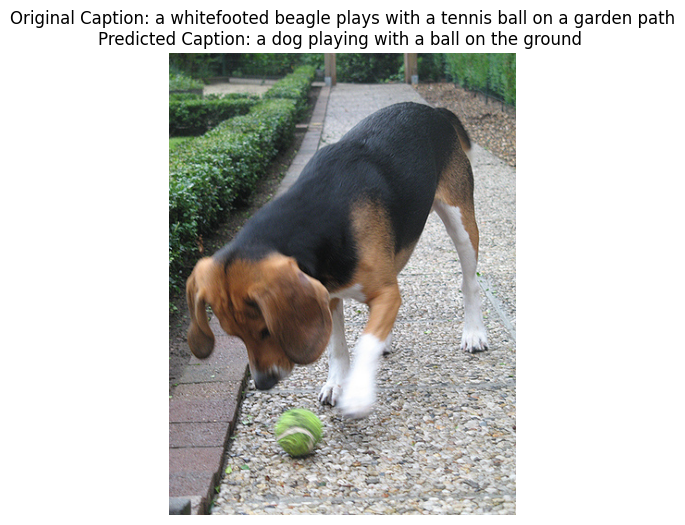

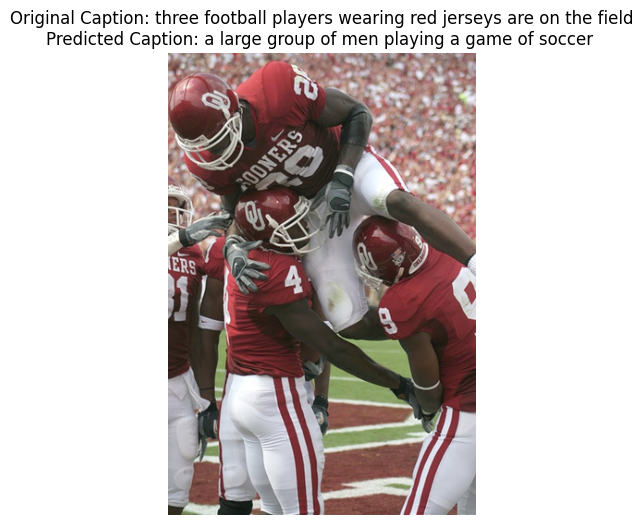

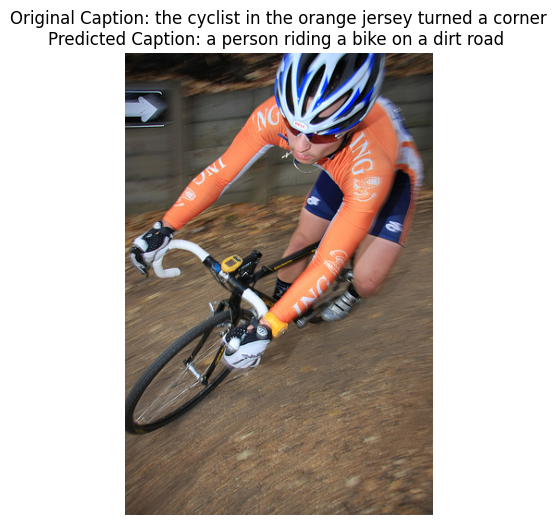

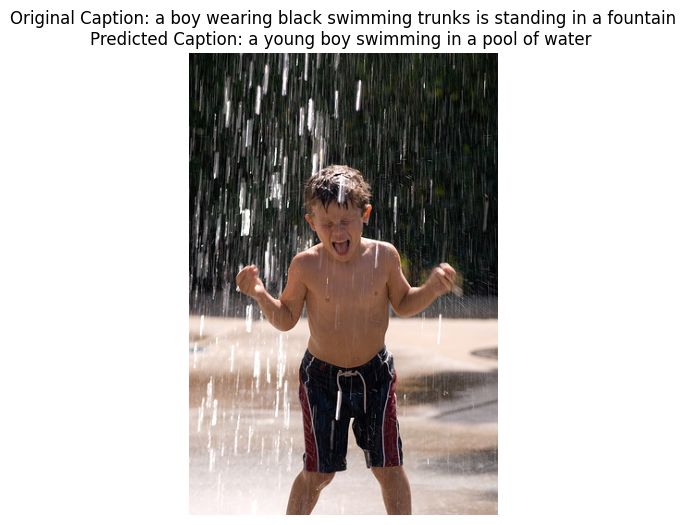

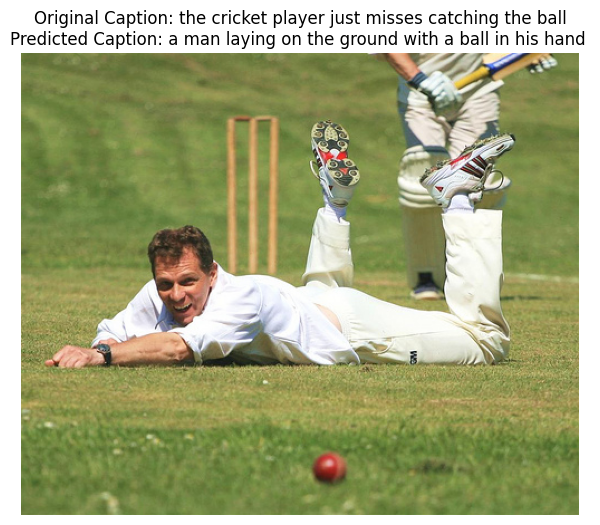

...

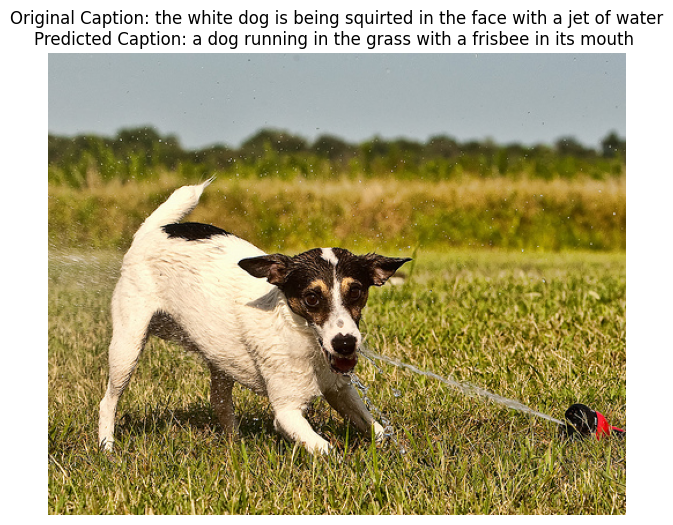

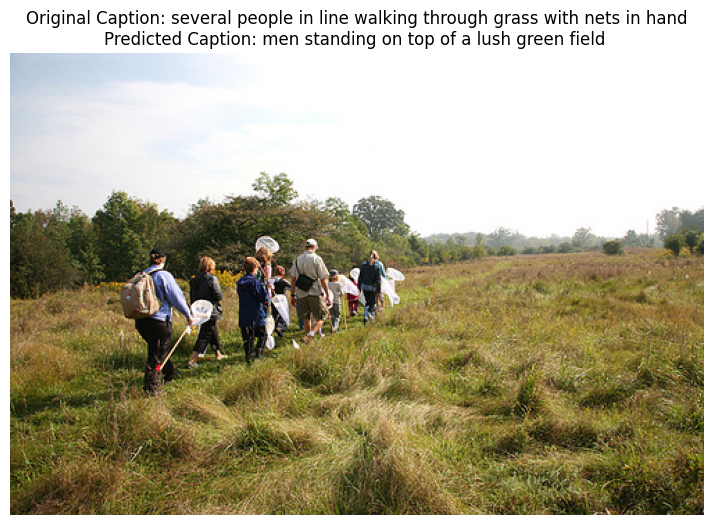

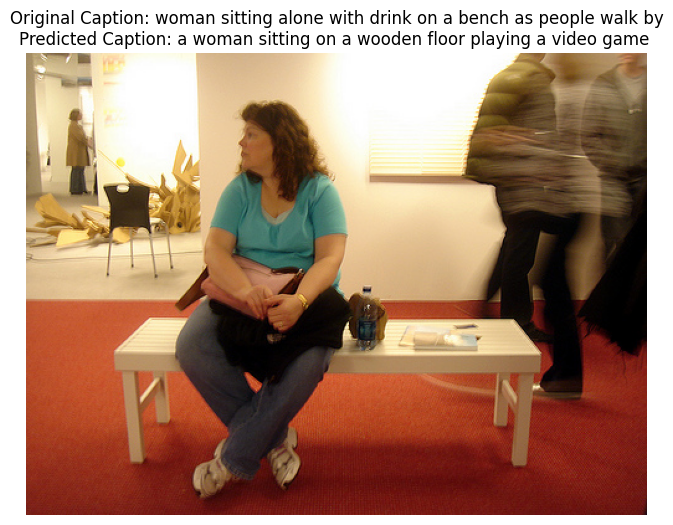

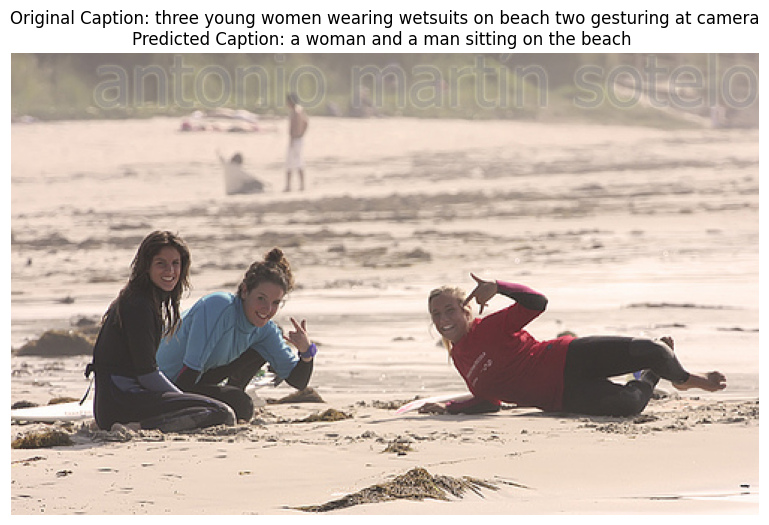

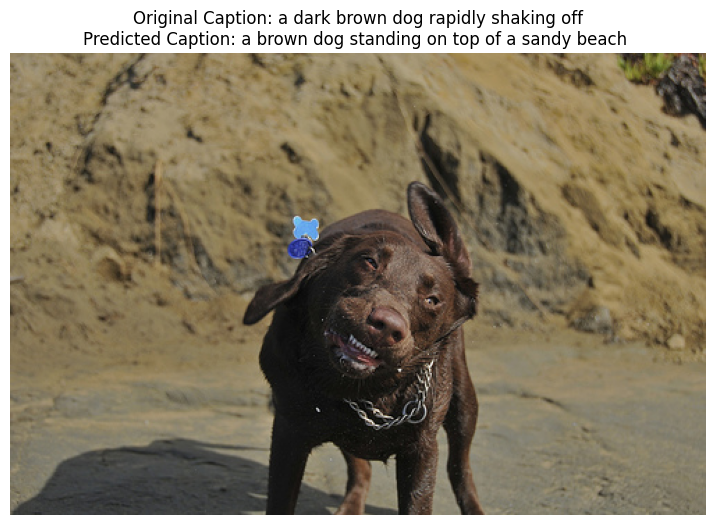

In [ ]:
def remove_tokens(caption):
    # Remove the 'startseq' and 'endseq' tokens
    caption = caption.replace('startseq ', '').replace(' endseq', '')
    return caption

def visualize_image_with_both_captions(image_file, captions_dict, original_captions, image_path):
    # Get the predicted caption for the image from captions_dict
    predicted_caption = captions_dict.get(image_file, "No predicted caption available")
    predicted_caption = remove_tokens(predicted_caption)  # Remove startseq and endseq from predicted caption

    # Get the original caption for the image from the DataFrame
    original_caption = original_captions.get(image_file, "No original caption available")
    original_caption = remove_tokens(original_caption)  # Remove startseq and endseq from original caption

    # Construct the image path
    img_path = os.path.join(image_path, image_file)

    # Open and display the image
    image = Image.open(img_path)
    plt.figure(figsize=(10, 6))
    plt.imshow(image)
    plt.axis('off')  # Hide axes
    plt.title(f"Original Caption: {original_caption}\nPredicted Caption: {predicted_caption}")
    plt.show()

# Create a dictionary to map image files to their original captions
original_captions_dict = {row['image']: row['caption'] for _, row in df.iterrows()}

# Visualize some images with both original and predicted captions
sample_images = list(captions_dict.keys())[20:50]  # Take a subset of 10 images for visualization

for img_file in sample_images:
    visualize_image_with_both_captions(img_file, captions_dict, original_captions_dict, image_path)


In [ ]:
# Load the pre-trained model
model_name = "nlpconnect/vit-gpt2-image-captioning"
model = VisionEncoderDecoderModel.from_pretrained(model_name)
image_processor = ViTImageProcessor.from_pretrained(model_name)
tokenizer = AutoTokenizer.from_pretrained(model_name)

# Set the model to evaluation mode
model.eval()

# Define the loss function (CrossEntropyLoss)
loss_fn = nn.CrossEntropyLoss(ignore_index=tokenizer.pad_token_id, reduction='mean')

# Function to calculate the loss for a batch of images and captions
def calculate_loss(batch_images, batch_captions, model, tokenizer, loss_fn, device):
    # Process the images and captions
    pixel_values = image_processor(batch_images, return_tensors="pt").pixel_values.to(device)
    target_ids = tokenizer(batch_captions, padding=True, return_tensors="pt").input_ids.to(device)

    # Forward pass: get model outputs
    outputs = model(pixel_values=pixel_values, labels=target_ids)

    # Get the loss
    loss = outputs.loss
    return loss.item()

# Example of how to compute loss for a sample batch
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Assuming `batch_images` is a list of images and `batch_captions` is a list of ground truth captions (for a batch)
batch_images = [Image.open(os.path.join(image_path, img_file)).convert('RGB') for img_file in sample_images]
batch_captions = [captions_dict[img_file] for img_file in sample_images]

# Calculate the loss for the sample batch
loss = calculate_loss(batch_images, batch_captions, model, tokenizer, loss_fn, device)
print(f"Loss: {loss}")


Config of the encoder: <class 'transformers.models.vit.modeling_vit.ViTModel'> is overwritten by shared encoder config: ViTConfig {
  "architectures": [
    "ViTModel"
  ],
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 768,
  "image_size": 224,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "model_type": "vit",
  "num_attention_heads": 12,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "pooler_act": "tanh",
  "pooler_output_size": 768,
  "qkv_bias": true,
  "torch_dtype": "float32",
  "transformers_version": "4.51.1"
}

Config of the decoder: <class 'transformers.models.gpt2.modeling_gpt2.GPT2LMHeadModel'> is overwritten by shared decoder config: GPT2Config {
  "activation_function": "gelu_new",
  "add_cross_attention": true,
  "architectures": [
    "GPT2LMHeadModel"
  ],
  "attn_pdrop": 0.1,
  "bos_token_id": 50256,
  "decoder_start_to

Loss: 9.468160629272461


In [ ]:
# Function to calculate BLEU score between two captions
def calculate_bleu_score(reference_caption, candidate_caption):
    # Tokenize captions
    reference_tokens = [reference_caption.lower().split()]
    candidate_tokens = candidate_caption.lower().split()

    # Calculate BLEU score
    bleu_score = sentence_bleu(reference_tokens, candidate_tokens)

    return bleu_score

# List to store BLEU scores for each image
bleu_scores = []

# Iterate through each image and calculate BLEU score
for img_file in df['image']:
    # Get the original caption for the image
    reference_caption = df.loc[df['image'] == img_file, 'caption'].values[0]

    # Get the predicted caption for the image
    predicted_caption = captions_dict.get(img_file, None)

    # If predicted caption exists, calculate BLEU score
    if predicted_caption:
        bleu_score = calculate_bleu_score(reference_caption, predicted_caption)
        bleu_scores.append(bleu_score)

# Calculate the average BLEU score across all images
average_bleu_score = sum(bleu_scores) / len(bleu_scores) if bleu_scores else 0
print(f"Average BLEU Score: {average_bleu_score}")


Average BLEU Score: 0.015113144824059729


# **GPT2**

In [ ]:
# Download latest version
path = kagglehub.dataset_download("adityajn105/flickr8k")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/flickr8k


In [ ]:
dataset_path = '/kaggle/input/flickr8k'  # Base directory
print("Dataset files in the directory:")
for root, dirs, files in os.walk(dataset_path):
    print(root)
    print(f"  Subdirectories: {dirs}")
    print(f"  Files: {files}")


Dataset files in the directory:
/kaggle/input/flickr8k
  Subdirectories: ['Images']
  Files: ['captions.txt']
/kaggle/input/flickr8k/Images
  Subdirectories: []
  Files: ['3226254560_2f8ac147ea.jpg', '214543992_ce6c0d9f9b.jpg', '2366643786_9c9a830db8.jpg', '3368819708_0bfa0808f8.jpg', '2190227737_6e0bde2623.jpg', '2752809449_632cd991b3.jpg', '3097776588_312932e438.jpg', '1206506157_c7956accd5.jpg', '1319634306_816f21677f.jpg', '2465218087_fca77998c6.jpg', '3351493005_6e5030f596.jpg', '2949337912_beba55698b.jpg', '534886684_a6c9f40fa1.jpg', '3543600125_223747ef4c.jpg', '2174206711_11cb712a8d.jpg', '280706862_14c30d734a.jpg', '2100735137_05c6079537.jpg', '3131632154_098f86f4cb.jpg', '2236016316_f476cbbf06.jpg', '3335375223_b4da8df523.jpg', '929679367_ff8c7df2ee.jpg', '241347214_5f19e7998c.jpg', '2998024845_1529c11694.jpg', '1317292658_ba29330a0b.jpg', '2521938720_911ac092f7.jpg', '3426933951_2302a941d8.jpg', '2410399168_1462c422d4.jpg', '2587106431_1cc0e719c6.jpg', '2339516180_12493e8ecf

In [ ]:
# Set paths for the flickr8k images

flickr_images_dir = '/kaggle/input/flickr8k/Images'  # Corrected path

# Check if the path exists
if os.path.exists(flickr_images_dir):
    print(f"Images directory exists: {flickr_images_dir}")
    print(f"Number of images: {len(os.listdir(flickr_images_dir))}")
else:
    print(f"Images directory not found: {flickr_images_dir}")



Images directory exists: /kaggle/input/flickr8k/Images
Number of images: 8091


In [ ]:
# Step 1: Extract features from images using a pre-trained CNN (ResNet-152)
def extract_image_features(image_dir, batch_size=32):
    """Extract features from images using a pre-trained CNN."""
    # Define image transformations
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
    ])

    # Load pre-trained ResNet-152 model
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")

    model = models.resnet152(pretrained=True)
    # Remove the last FC layer to get features
    model = torch.nn.Sequential(*list(model.children())[:-1])
    model = model.to(device)
    model.eval()

    # Get list of image files
    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
    print(f"Total images to process: {len(image_files)}")

    # Process images in batches
    features_dict = {}

    for i in tqdm(range(0, len(image_files), batch_size)):
        batch_files = image_files[i:i+batch_size]
        batch_images = []
        batch_file_names = []

        for img_file in batch_files:
            img_path = os.path.join(image_dir, img_file)
            try:
                image = Image.open(img_path).convert('RGB')
                image = transform(image)
                batch_images.append(image)
                batch_file_names.append(img_file)
            except Exception as e:
                print(f"Error processing {img_file}: {e}")

        # Skip empty batches
        if not batch_images:
            continue

        # Convert list to tensor
        batch_tensor = torch.stack(batch_images).to(device)

        # Extract features
        with torch.no_grad():
            batch_features = model(batch_tensor)
            batch_features = batch_features.squeeze().cpu().numpy()

        # Store features
        for idx, img_file in enumerate(batch_file_names):
            if len(batch_features.shape) == 1:  # Only one image in batch
                features_dict[img_file] = batch_features
            else:
                features_dict[img_file] = batch_features[idx]

    # Save features
    with open('image_features_flickr8k.pkl', 'wb') as f:
        pickle.dump(features_dict, f)

    print(f"Features extracted and saved for {len(features_dict)} images!")
    return features_dict


In [ ]:
# Step 2: Generate captions using a pre-trained image captioning model
def generate_captions(image_dir):
    """Generate captions for images using a pre-trained model."""
    # Load pre-trained model and processors
    model = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
    image_processor = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
    tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Set generation parameters
    model.config.decoder_start_token_id = tokenizer.cls_token_id
    model.config.pad_token_id = tokenizer.pad_token_id
    model.config.vocab_size = model.config.decoder.vocab_size

    max_length = 16
    num_beams = 4
    gen_kwargs = {"max_length": max_length, "num_beams": num_beams}

    # Get list of image files
    image_files = [f for f in os.listdir(image_dir) if f.endswith(('.jpg', '.jpeg', '.png'))]
    print(f"Total images to process: {len(image_files)}")

    # Generate captions
    captions_dict = {}

    for img_file in tqdm(image_files):
        img_path = os.path.join(image_dir, img_file)
        try:
            image = Image.open(img_path).convert('RGB')

            # Preprocess image
            pixel_values = image_processor(image, return_tensors="pt").pixel_values
            pixel_values = pixel_values.to(device)

            # Generate caption
            output_ids = model.generate(pixel_values, **gen_kwargs)

            # Decode caption
            caption = tokenizer.batch_decode(output_ids, skip_special_tokens=True)[0]
            captions_dict[img_file] = caption

        except Exception as e:
            print(f"Error processing {img_file}: {e}")

    # Save captions
    with open('generated_captions_flickr8k.pkl', 'wb') as f:
        pickle.dump(captions_dict, f)

    print(f"Captions generated for {len(captions_dict)} images!")
    return captions_dict

In [ ]:
# Step 3: Visualize some examples
def visualize_examples(image_dir, captions_dict, num_examples=10):
    """Visualize some examples of images and their generated captions."""
    # Get list of image files
    image_files = list(captions_dict.keys())

    # Select random images
    import random
    random.shuffle(image_files)
    selected_images = image_files[:num_examples]

    # Create a figure
    plt.figure(figsize=(15, 10))

    for i, img_file in enumerate(selected_images):
        # Load the image
        img_path = os.path.join(image_dir, img_file)
        image = Image.open(img_path).convert('RGB')

        # Get the caption
        caption = captions_dict[img_file]

        # Display image and caption
        plt.subplot(num_examples, 1, i+1)
        plt.imshow(image)
        plt.title(f"Image: {img_file}")
        plt.xlabel(f"Generated Caption: {caption}")
        plt.xticks([])
        plt.yticks([])

    plt.tight_layout()
    plt.show()


In [ ]:
def save_model(model, image_processor, tokenizer):
    """Save the trained model, image processor, and tokenizer."""
    try:
        model.save_pretrained("trained_vit_gpt2_flickr8k")
        image_processor.save_pretrained("trained_vit_gpt2_flickr8k")
        tokenizer.save_pretrained("trained_vit_gpt2_flickr8k")
        print("Model, image processor, and tokenizer saved!")
    except Exception as e:
        print(f"Error while saving the model: {e}")

In [ ]:
# Step 1: Extract features from images
print("Extracting image features...")
features_dict = extract_image_features(flickr_images_dir)

Extracting image features...
Using device: cuda


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet152-394f9c45.pth" to /root/.cache/torch/hub/checkpoints/resnet152-394f9c45.pth
100%|██████████| 230M/230M [00:01<00:00, 185MB/s]


Total images to process: 8091


100%|██████████| 253/253 [02:27<00:00,  1.72it/s]

Features extracted and saved for 8091 images!


In [ ]:
# Step 2: Generate captions for images
print("Generating captions...")
captions_dict = generate_captions(flickr_images_dir)

Generating captions...


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


pytorch_model.bin:   0%|          | 0.00/982M [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/982M [00:00<?, ?B/s]

Config of the encoder: <class 'transformers.models.vit.modeling_vit.ViTModel'> is overwritten by shared encoder config: ViTConfig {
  "architectures": [
    "ViTModel"
  ],
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 768,
  "image_size": 224,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "model_type": "vit",
  "num_attention_heads": 12,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "pooler_act": "tanh",
  "pooler_output_size": 768,
  "qkv_bias": true,
  "torch_dtype": "float32",
  "transformers_version": "4.51.3"
}

Config of the decoder: <class 'transformers.models.gpt2.modeling_gpt2.GPT2LMHeadModel'> is overwritten by shared decoder config: GPT2Config {
  "activation_function": "gelu_new",
  "add_cross_attention": true,
  "architectures": [
    "GPT2LMHeadModel"
  ],
  "attn_pdrop": 0.1,
  "bos_token_id": 50256,
  "decoder_start_to

preprocessor_config.json:   0%|          | 0.00/228 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/241 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/120 [00:00<?, ?B/s]

Total images to process: 8091


  0%|          | 0/8091 [00:00<?, ?it/s]The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
We strongly recommend passing in an `attention_mask` since your input_ids may be padded. See https://huggingface.co/docs/transformers/troubleshooting#incorrect-output-when-padding-tokens-arent-masked.
You may ignore this warning if your `pad_token_id` (50256) is identical to the `bos_token_id` (50256), `eos_token_id` (50256), or the `sep_token_id` (None), and your input is not padded.
100%|██████████| 8091/8091 [32:41<00:00,  4.13it/s]

Captions generated for 8091 images!


Visualizing examples...


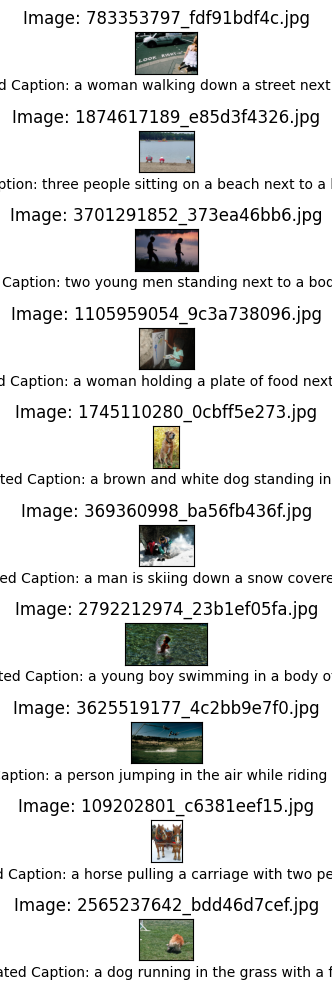

In [ ]:
# Step 3: Visualize some examples
print("Visualizing examples...")
visualize_examples(flickr_images_dir, captions_dict)


# **FLASK**

In [ ]:
from flask import Flask, request, jsonify
import torch
from transformers import VisionEncoderDecoderModel, ViTImageProcessor, AutoTokenizer
from transformers import BlipProcessor, BlipForConditionalGeneration
from PIL import Image
import io
import base64
import threading
import nltk
from nltk.translate.bleu_score import sentence_bleu

# Download NLTK data for BLEU score calculation
try:
    nltk.data.find('tokenizers/punkt')
except LookupError:
    nltk.download('punkt')

app = Flask(__name__)

# Load the pre-trained models and processors
def load_models():
    # Load ViT-GPT2 model
    vit_gpt2_model = VisionEncoderDecoderModel.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
    vit_image_processor = ViTImageProcessor.from_pretrained("nlpconnect/vit-gpt2-image-captioning")
    vit_tokenizer = AutoTokenizer.from_pretrained("nlpconnect/vit-gpt2-image-captioning")

    # Load BLIP model
    blip_processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
    blip_model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Move models to device
    vit_gpt2_model.to(device)
    blip_model.to(device)

    # Set generation parameters for ViT-GPT2
    vit_gpt2_model.config.decoder_start_token_id = vit_tokenizer.cls_token_id
    vit_gpt2_model.config.pad_token_id = vit_tokenizer.pad_token_id
    vit_gpt2_model.config.vocab_size = vit_gpt2_model.config.decoder.vocab_size

    return {
        'vit_gpt2': {
            'model': vit_gpt2_model,
            'processor': vit_image_processor,
            'tokenizer': vit_tokenizer
        },
        'blip': {
            'model': blip_model,
            'processor': blip_processor
        },
        'device': device
    }

# Generate caption using ViT-GPT2 model
def generate_vit_gpt2_caption(image, model_data):
    model = model_data['vit_gpt2']['model']
    processor = model_data['vit_gpt2']['processor']
    tokenizer = model_data['vit_gpt2']['tokenizer']
    device = model_data['device']

    # Set generation parameters
    max_length = 16
    num_beams = 4
    gen_kwargs = {"max_length": max_length, "num_beams": num_beams}

    # Preprocess image
    pixel_values = processor(image, return_tensors="pt").pixel_values
    pixel_values = pixel_values.to(device)

    # Generate caption
    output_ids = model.generate(pixel_values, **gen_kwargs)

    # Decode caption
    caption = tokenizer.batch_decode(output_ids, skip_special_tokens=True)[0]

    return caption

# Generate caption using BLIP model
def generate_blip_caption(image, model_data):
    model = model_data['blip']['model']
    processor = model_data['blip']['processor']
    device = model_data['device']

    # Preprocess image
    inputs = processor(image, return_tensors="pt").to(device)

    # Generate caption
    output = model.generate(**inputs, max_length=30)

    # Decode caption
    caption = processor.decode(output[0], skip_special_tokens=True)

    return caption

# Calculate BLEU score between two captions
def calculate_bleu_score(reference_caption, candidate_caption):
    # Tokenize captions
    reference_tokens = [reference_caption.lower().split()]
    candidate_tokens = candidate_caption.lower().split()

    # Calculate BLEU score
    bleu_score = sentence_bleu(reference_tokens, candidate_tokens)

    return bleu_score

# Load models at startup
model_data = load_models()
print(f"Models loaded on {model_data['device']}")

# API endpoint for ViT-GPT2 caption generation
@app.route('/predict_vit_gpt2', methods=['POST'])
def predict_vit_gpt2():
    if 'image' not in request.json:
        return jsonify({'error': 'No image provided'}), 400

    try:
        # Get the base64 encoded image
        image_data = request.json['image']

        # Decode the base64 image
        image_bytes = base64.b64decode(image_data)
        image = Image.open(io.BytesIO(image_bytes)).convert('RGB')

        # Generate caption from ViT-GPT2 model
        vit_gpt2_caption = generate_vit_gpt2_caption(image, model_data)

        return jsonify({
            'caption': vit_gpt2_caption
        })

    except Exception as e:
        return jsonify({'error': str(e)}), 500

# API endpoint for BLIP caption generation
@app.route('/predict_blip', methods=['POST'])
def predict_blip():
    if 'image' not in request.json:
        return jsonify({'error': 'No image provided'}), 400

    try:
        # Get the base64 encoded image
        image_data = request.json['image']

        # Decode the base64 image
        image_bytes = base64.b64decode(image_data)
        image = Image.open(io.BytesIO(image_bytes)).convert('RGB')

        # Generate caption from BLIP model
        blip_caption = generate_blip_caption(image, model_data)

        return jsonify({
            'caption': blip_caption
        })

    except Exception as e:
        return jsonify({'error': str(e)}), 500

# API endpoint for calculating BLEU score
@app.route('/calculate_bleu', methods=['POST'])
def calculate_bleu():
    if 'vit_caption' not in request.json or 'blip_caption' not in request.json:
        return jsonify({'error': 'Both captions are required'}), 400

    try:
        vit_caption = request.json['vit_caption']
        blip_caption = request.json['blip_caption']

        # Calculate BLEU scores
        vit_to_blip_bleu = calculate_bleu_score(blip_caption, vit_caption)
        blip_to_vit_bleu = calculate_bleu_score(vit_caption, blip_caption)

        return jsonify({
            'vit_to_blip_bleu': vit_to_blip_bleu,
            'blip_to_vit_bleu': blip_to_vit_bleu
        })

    except Exception as e:
        return jsonify({'error': str(e)}), 500

# HTML template for the web interface
@app.route('/')
def index():
    return """
    <!DOCTYPE html>
    <html>
    <head>
        <title>Dual Model Image Caption Generator</title>
        <style>
            body {
                font-family: Arial, sans-serif;
                max-width: 800px;
                margin: 0 auto;
                padding: 20px;
                background-color: #f5f5f5;
            }
            .container {
                display: flex;
                flex-direction: column;
                align-items: center;
                background-color: white;
                padding: 20px;
                border-radius: 10px;
                box-shadow: 0 0 10px rgba(0,0,0,0.1);
            }
            h1 {
                color: #333;
            }
            .upload-section {
                margin: 20px 0;
                width: 100%;
            }
            .image-preview {
                margin: 20px 0;
                max-width: 500px;
                max-height: 500px;
                border-radius: 5px;
            }
            .caption-result {
                font-size: 18px;
                margin: 20px 0;
                padding: 15px;
                background-color: #f0f0f0;
                border-radius: 5px;
                width: 100%;
                box-sizing: border-box;
            }
            .model-caption {
                margin: 10px 0;
                padding: 10px;
                border-left: 4px solid #4CAF50;
            }
            .bleu-score {
                font-size: 14px;
                color: #666;
                margin-top: 5px;
            }
            .hidden {
                display: none;
            }
            button {
                background-color: #4CAF50;
                color: white;
                padding: 10px 20px;
                border: none;
                border-radius: 5px;
                cursor: pointer;
                font-size: 16px;
                margin-top: 10px;
            }
            button:hover {
                background-color: #45a049;
            }
            input[type="file"] {
                margin: 10px 0;
            }
            .loading {
                border: 5px solid #f3f3f3;
                border-top: 5px solid #3498db;
                border-radius: 50%;
                width: 30px;
                height: 30px;
                animation: spin 2s linear infinite;
                margin: 20px auto;
            }
            @keyframes spin {
                0% { transform: rotate(0deg); }
                100% { transform: rotate(360deg); }
            }
        </style>
    </head>
    <body>
        <div class="container">
            <h1>Dual Model Image Caption Generator</h1>
            <p>Upload an image to generate captions from two different models</p>

            <div class="upload-section">
                <input type="file" id="imageInput" accept="image/*">
                <button id="generateBtn">Generate Captions</button>
            </div>

            <div id="imagePreview" class="hidden">
                <h3>Image Preview:</h3>
                <img id="preview" class="image-preview">
            </div>

            <div id="loadingIndicator" class="hidden">
                <div class="loading"></div>
                <p>Generating captions...</p>
            </div>

            <div id="captionResult" class="caption-result hidden">
                <h3>Generated Captions:</h3>
                <div class="model-caption">
                    <strong>ViT-GPT2 Model:</strong>
                    <p id="vit-gpt2-caption">Loading...</p>
                    <div class="bleu-score">BLEU Score: <span id="vit-bleu-score">-</span></div>
                </div>
                <div class="model-caption">
                    <strong>BLIP Model:</strong>
                    <p id="blip-caption">Loading...</p>
                    <div class="bleu-score">BLEU Score: <span id="blip-bleu-score">-</span></div>
                </div>
            </div>
        </div>

        <script>
            // Preview the selected image
            document.getElementById('imageInput').addEventListener('change', function(event) {
                const file = event.target.files[0];
                if (file) {
                    const reader = new FileReader();
                    reader.onload = function(e) {
                        document.getElementById('preview').src = e.target.result;
                        document.getElementById('imagePreview').classList.remove('hidden');
                        document.getElementById('captionResult').classList.add('hidden');
                    };
                    reader.readAsDataURL(file);
                }
            });

            // Generate captions when button is clicked
            document.getElementById('generateBtn').addEventListener('click', function() {
                const fileInput = document.getElementById('imageInput');
                if (fileInput.files.length === 0) {
                    alert('Please select an image first');
                    return;
                }

                const file = fileInput.files[0];
                const reader = new FileReader();

                document.getElementById('loadingIndicator').classList.remove('hidden');
                document.getElementById('captionResult').classList.add('hidden');

                reader.onload = function(e) {
                    const base64Image = e.target.result.split(',')[1];

                    // Show caption result area with loading indicators
                    document.getElementById('captionResult').classList.remove('hidden');
                    document.getElementById('vit-gpt2-caption').textContent = "Loading...";
                    document.getElementById('blip-caption').textContent = "Loading...";
                    document.getElementById('vit-bleu-score').textContent = "-";
                    document.getElementById('blip-bleu-score').textContent = "-";

                    let vitCaption = '';
                    let blipCaption = '';

                    // Call ViT-GPT2 endpoint
                    fetch('/predict_vit_gpt2', {
                        method: 'POST',
                        headers: {
                            'Content-Type': 'application/json'
                        },
                        body: JSON.stringify({
                            image: base64Image
                        })
                    })
                    .then(response => response.json())
                    .then(data => {
                        vitCaption = data.caption;
                        document.getElementById('vit-gpt2-caption').textContent = vitCaption;

                        // If both captions are ready, calculate BLEU scores
                        if (blipCaption) {
                            calculateBleuScores(vitCaption, blipCaption);
                        }
                    })
                    .catch(error => {
                        document.getElementById('vit-gpt2-caption').textContent = "Error: " + error;
                    });

                    // Call BLIP endpoint
                    fetch('/predict_blip', {
                        method: 'POST',
                        headers: {
                            'Content-Type': 'application/json'
                        },
                        body: JSON.stringify({
                            image: base64Image
                        })
                    })
                    .then(response => response.json())
                    .then(data => {
                        blipCaption = data.caption;
                        document.getElementById('blip-caption').textContent = blipCaption;
                        document.getElementById('loadingIndicator').classList.add('hidden');

                        // If both captions are ready, calculate BLEU scores
                        if (vitCaption) {
                            calculateBleuScores(vitCaption, blipCaption);
                        }
                    })
                    .catch(error => {
                        document.getElementById('blip-caption').textContent = "Error: " + error;
                        document.getElementById('loadingIndicator').classList.add('hidden');
                    });
                };

                reader.readAsDataURL(file);
            });

            // Calculate BLEU scores
            function calculateBleuScores(vitCaption, blipCaption) {
                fetch('/calculate_bleu', {
                    method: 'POST',
                    headers: {
                        'Content-Type': 'application/json'
                    },
                    body: JSON.stringify({
                        vit_caption: vitCaption,
                        blip_caption: blipCaption
                    })
                })
                .then(response => response.json())
                .then(data => {
                    document.getElementById('vit-bleu-score').textContent = data.vit_to_blip_bleu.toFixed(4);
                    document.getElementById('blip-bleu-score').textContent = data.blip_to_vit_bleu.toFixed(4);
                })
                .catch(error => {
                    console.error("Error calculating BLEU scores:", error);
                });
            }
        </script>
    </body>
    </html>
    """

# For Google Colab, we'll use Colab's built-in method to expose the app
def run_in_colab():
    from google.colab.output import eval_js
    print("Starting Flask server...")

    # Start the Flask app in a separate thread
    threading.Thread(target=lambda: app.run(host='0.0.0.0', port=8000, debug=False, use_reloader=False)).start()

    # Use JavaScript to create a proxy
    js = """
    async function setupProxy() {
      const url = await google.colab.kernel.proxyPort(8000);
      const iframe = document.createElement('iframe');
      iframe.src = url + '?v=' + new Date().getTime();  // Add timestamp to prevent caching
      iframe.width = '100%';
      iframe.height = '800px';
      iframe.frameBorder = 0;
      document.body.appendChild(iframe);
      return url;
    }
    setupProxy()
    """
    public_url = eval_js(js)
    print(f"Flask app running at: {public_url}")

# Run the Flask app
if __name__ == '__main__':
    try:
        # Check if running in Colab
        from google.colab import output
        run_in_colab()
    except ImportError:
        # If not in Colab, run normally
        app.run(debug=True, host='0.0.0.0', port=8000)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


pytorch_model.bin:   0%|          | 0.00/982M [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/982M [00:00<?, ?B/s]

Config of the encoder: <class 'transformers.models.vit.modeling_vit.ViTModel'> is overwritten by shared encoder config: ViTConfig {
  "architectures": [
    "ViTModel"
  ],
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 768,
  "image_size": 224,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "model_type": "vit",
  "num_attention_heads": 12,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "pooler_act": "tanh",
  "pooler_output_size": 768,
  "qkv_bias": true,
  "torch_dtype": "float32",
  "transformers_version": "4.51.3"
}

Config of the decoder: <class 'transformers.models.gpt2.modeling_gpt2.GPT2LMHeadModel'> is overwritten by shared decoder config: GPT2Config {
  "activation_function": "gelu_new",
  "add_cross_attention": true,
  "architectures": [
    "GPT2LMHeadModel"
  ],
  "attn_pdrop": 0.1,
  "bos_token_id": 50256,
  "decoder_start_to

preprocessor_config.json:   0%|          | 0.00/228 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/241 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/798k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/120 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/287 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/506 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/711k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/990M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/990M [00:00<?, ?B/s]

Models loaded on cpu
Starting Flask server...
 * Serving Flask app '__main__'
 * Debug mode: off


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on all addresses (0.0.0.0)
 * Running on http://127.0.0.1:8000
 * Running on http://172.28.0.12:8000
INFO:werkzeug:Press CTRL+C to quit


Flask app running at: https://8000-m-s-2m6yby8kqbs5i-b.us-central1-0.prod.colab.dev
